In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/deepfake/df_horizontal.mp4
/kaggle/input/deepfake/fakevideo.mp4
/kaggle/input/deepfake/realvideo.mp4
/kaggle/input/deepfake/df_vertical.mp4
/kaggle/input/deepfake-detection-challenge/sample_submission.csv
/kaggle/input/deepfake-detection-challenge/test_videos/qooxnxqqjb.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/hierggamuo.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/ocgdbrgmtq.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/icbsahlivv.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/prhmixykhr.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/ihglzxzroo.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/yarpxfqejd.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/orixbcfvdz.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/qxyrtwozyw.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/hqzwudvhih.mp4
/kaggle/input/deepfake-detection-challenge/test_videos/ghnpsltzyn.mp4
/kaggle/inp

In [2]:
a="/kaggle/input/deepfake-detection-challenge/train_sample_videos"
ext=[]
for i in os.listdir(a):
    i=i.split('.')[1]
    if(i not in ext):
        ext.append(i)
ext

['mp4', 'json']

In [3]:
json_folder=[file for file in os.listdir(a) if file.endswith('json')][0]
json_folder

'metadata.json'

In [4]:
json=os.path.join(a,json_folder)
df=pd.read_json(json)
df=df.T
df

,label,split,original
aagfhgtpmv.mp4,FAKE,train,vudstovrck.mp4
aapnvogymq.mp4,FAKE,train,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,train,None
abofeumbvv.mp4,FAKE,train,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,train,qzimuostzz.mp4
...,...,...,...
etejaapnxh.mp4,FAKE,train,wtreibcmgm.mp4
etmcruaihe.mp4,FAKE,train,afoovlsmtx.mp4
etohcvnzbj.mp4,FAKE,train,bdnaqemxmr.mp4
eudeqjhdfd.mp4,REAL,train,None


In [5]:
df[df["label"]=='FAKE'].count()

label       323
split       323
original    323
dtype: int64

In [6]:
df=df.drop('split',axis=1)
df

,label,original
aagfhgtpmv.mp4,FAKE,vudstovrck.mp4
aapnvogymq.mp4,FAKE,jdubbvfswz.mp4
abarnvbtwb.mp4,REAL,None
abofeumbvv.mp4,FAKE,atvmxvwyns.mp4
abqwwspghj.mp4,FAKE,qzimuostzz.mp4
...,...,...
etejaapnxh.mp4,FAKE,wtreibcmgm.mp4
etmcruaihe.mp4,FAKE,afoovlsmtx.mp4
etohcvnzbj.mp4,FAKE,bdnaqemxmr.mp4
eudeqjhdfd.mp4,REAL,None


In [7]:
y=df['label']
df=df.drop('label',axis=1)
print(df)
y

                      original
aagfhgtpmv.mp4  vudstovrck.mp4
aapnvogymq.mp4  jdubbvfswz.mp4
abarnvbtwb.mp4            None
abofeumbvv.mp4  atvmxvwyns.mp4
abqwwspghj.mp4  qzimuostzz.mp4
...                        ...
etejaapnxh.mp4  wtreibcmgm.mp4
etmcruaihe.mp4  afoovlsmtx.mp4
etohcvnzbj.mp4  bdnaqemxmr.mp4
eudeqjhdfd.mp4            None
eukvucdetx.mp4  gjypopglvi.mp4

[400 rows x 1 columns]


aagfhgtpmv.mp4    FAKE
aapnvogymq.mp4    FAKE
abarnvbtwb.mp4    REAL
abofeumbvv.mp4    FAKE
abqwwspghj.mp4    FAKE
                  ... 
etejaapnxh.mp4    FAKE
etmcruaihe.mp4    FAKE
etohcvnzbj.mp4    FAKE
eudeqjhdfd.mp4    REAL
eukvucdetx.mp4    FAKE
Name: label, Length: 400, dtype: object

In [9]:
import cv2
def extract_frames(video,num_frames=120):
    frame=[]
    cap=cv2.VideoCapture(video)
    while len(frame)<num_frames:
        ret,fra=cap.read()
        if not ret:
            break
        fra=cv2.resize(fra,(112,112))
        frame.append(fra)
    return frame

In [10]:
def heatmap(image):
    prev_gray=cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    heatmap=cv2.applyColorMap(prev_gray,cv2.COLORMAP_JET)
    return heatmap

In [11]:
from skimage.metrics import structural_similarity as ssim
def compare_heatmaps(frames, ssim_threshold=0.5):
    if len(frames) == 0:
        print("Error: No frames to compare")
        return "Unknown", -1

    prev_heatmap = heatmap(frames[0])
    prev_gray = cv2.cvtColor(prev_heatmap, cv2.COLOR_BGR2GRAY)
    inconsistencies = 0
    for i in range(1, len(frames)):
        next_heatmap = heatmap(frames[i])
        next_gray = cv2.cvtColor(next_heatmap, cv2.COLOR_BGR2GRAY)
        ssim_value = ssim(prev_gray, next_gray)        
        if ssim_value < ssim_threshold:
            inconsistencies += 1
        prev_gray = next_gray
        
    if inconsistencies > (len(frames) * 0.1):  # More than 10% of frames show inconsistencies
        return "Real"
    else:
        return "Fake"

In [12]:
import matplotlib.pyplot as plt
def display_frames(frames, num_display=5):
    plt.figure(figsize=(10, 5))
    for i in range(min(num_display, len(frames))):
        plt.subplot(2, num_display, i+1)
        plt.imshow(cv2.cvtColor(frames[i], cv2.COLOR_BGR2RGB))
        plt.title(f"Frame {i+1}")
        plt.axis('off')
        
        heat = heatmap(frames[i])
        plt.subplot(2, num_display, i + 1)
        plt.imshow(cv2.cvtColor(heat, cv2.COLOR_BGR2RGB))
        plt.title(f"Heatmap {i+1}")
        plt.axis('off')
    plt.show()

/opt/conda/lib/python3.6/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  "Adding an axes using the same arguments as a previous axes "


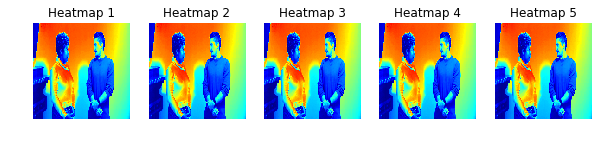

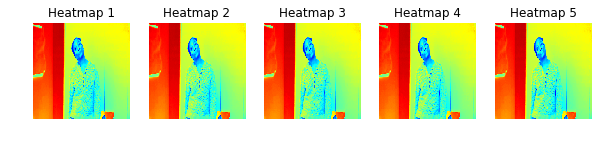

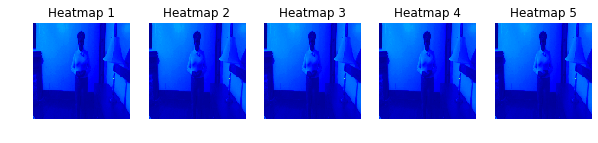

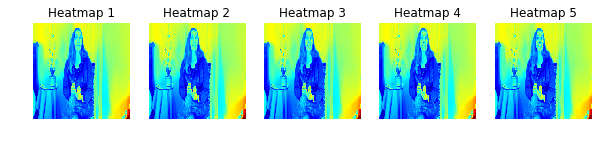

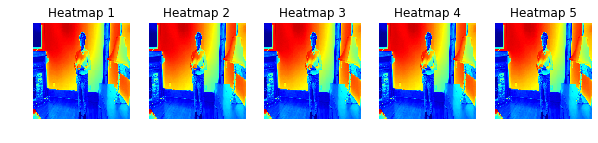

...

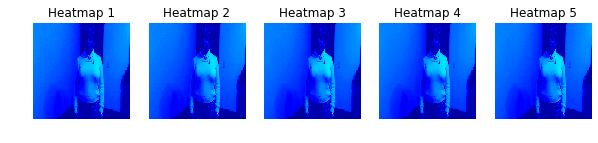

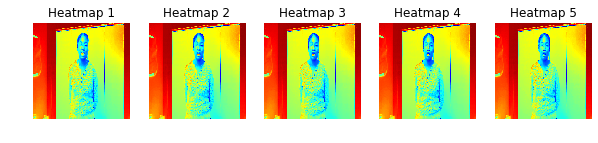

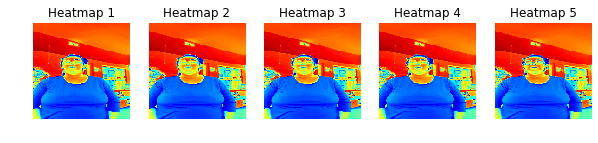

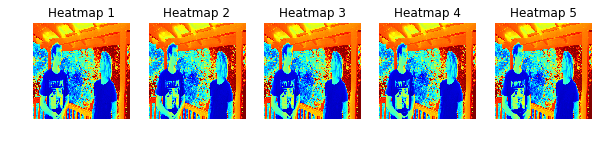

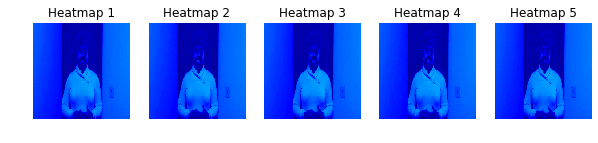

In [13]:
y_pred=[]
for i in df.index:
    frames=extract_frames(os.path.join(a,i))
    ans=compare_heatmaps(frames)
    if(ans=='Fake'):
        display_frames(frames)
    y_pred.append(ans)

In [14]:
y_pred

['Real',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Real',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Real',
 'Fake',
 'Fake',
 'Real',
 'Fake',
 'Fake',
 'Fake',
 'Real',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Real',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Real',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Real',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 'Fake',
 

In [15]:
y_predict=[1 if i=="Real" else 0 for i in y_pred]
y_true=[1 if i=="REAL" else 0 for i in y]

In [16]:
print(y_predict)
print(y_true)

[1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [17]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report


# Calculate evaluation metrics
accuracy = accuracy_score(y_true, y_predict)
precision = precision_score(y_true, y_predict)
recall = recall_score(y_true, y_predict)
f1 = f1_score(y_true, y_predict)
conf_matrix = confusion_matrix(y_true, y_predict)
class_report = classification_report(y_true, y_predict)

# Print the results
print(f"Accuracy: {accuracy:.2f}")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")
print("Confusion Matrix:")
print(conf_matrix)
print("Classification Report:")
print(class_report)

Accuracy: 0.79
Precision: 0.29
Recall: 0.06
F1 Score: 0.11
Confusion Matrix:
[[311  12]
 [ 72   5]]
Classification Report:
              precision    recall  f1-score   support

           0       0.81      0.96      0.88       323
           1       0.29      0.06      0.11        77

    accuracy                           0.79       400
   macro avg       0.55      0.51      0.49       400
weighted avg       0.71      0.79      0.73       400



In [18]:
def test_video(video):
    print(video)
    frames=extract_frames(video)
    ans=compare_heatmaps(frames)
    display_frames(frames)
    return ans

/kaggle/input/deepfake/fakevideo.mp4


/opt/conda/lib/python3.6/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning: 
Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  "Adding an axes using the same arguments as a previous axes "


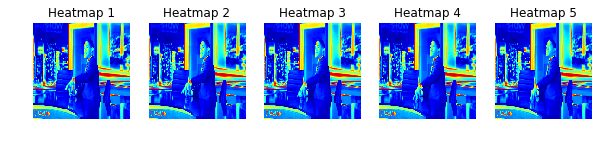

Fake


In [19]:
video='/kaggle/input/deepfake/fakevideo.mp4'
res=test_video(video)
print(res)